# Práctico 8 Procesamiento de Imágenes: Compresión


***

## Profesores:  
- Claudio Delrieux  

- Steven Martinez Vargas


## Alumno:  
- Leandro Bognino	36887290  



___

## Consigna:  

Implementar un aplicativo que permita abrir una imagen y con esta obtener:  
• Downsampling X2 (mostrando la imagen resultado al doble de tamaño para comparar el efecto) utilizando kernel constante, bilineal, y bicúbico.  
• Upsampling X2 (mostrando la imagen original al doble de tamaño para comparar el efecto) utilizando kernel constante, bilineal, y bicúbico.  
• Cuantización a cantidad de niveles de gris variable, utilizando uniforme, dithering aleatorio, y difusión del error por scan-line.  
Todas las funciones de Downsamplig, Upsampling y Cuantización deben ser desarrolladas como funciones propias y NO con funciones de biblioteca. Les sugiero recorrer la imagen mediante ciclos for anidados para una fácil implementación.  
**Fecha de entrega: 08 de Dicembre.**

### Dependencias e inclusión de librerías

In [1]:
import numpy as np
import imageio as io
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display
from skimage.transform import resize
from scipy import interpolate # Solo para contrastar

### 0. Funciones de soporte desarrolladas en los trabajos previos

In [2]:
# Descargar, leer, normalizar la imagen.
def get_and_read_img (url, name=''):
  img = io.imread(url)
  img = np.clip(img/255.,0.,1.)
  #img = resize(img,(600,600))
  return img

# RGB a YIQ
def rgb2yiq (img):
  RGB_2_YIQ_MATRIX = np.array([[ 0.299, 0.587, 0.114], 
                               [ 0.595716, -0.274453, -0.321263], 
                               [ 0.211456, -0.522591, 0.311135]])
  
  im_yiq =  np.copy(img)
  for i in range(len(img)):
    for j in range(len(img[0])):
        im_yiq[i][j] = RGB_2_YIQ_MATRIX.dot(img[i][j])

  im_yiq[:,:,0] = np.clip(im_yiq[:,:,0],0,1)
  im_yiq[:,:,1] = np.clip(im_yiq[:,:,1],-0.5957, 0.5957)
  im_yiq[:,:,2] = np.clip(im_yiq[:,:,2],-0.5226, 0.5226)

  return im_yiq

# YIQ a RGB
def yiq2rgb (img):
  YIQ_2_RGB_MATRIX = np.array([[1, 0.9663, 0.6210], 
                              [1, -0.2721, -0.6474], 
                              [1, -1.1070, 1.7046]])
  im_rgb =  np.copy(img)
  for i in range(len(img)):
    for j in range(len(img[0])):
        im_rgb[i][j] = np.clip(YIQ_2_RGB_MATRIX.dot(img[i][j]),0,1)

  return im_rgb

In [3]:
def filter_image(image, kernel):
    imagen_filtrada = np.copy(image)
    imagen_con_borde = np.pad(np.copy(image), pad_width=int(len(kernel)/2), mode='reflect')

    for i in range(len(image)):
        for j in range(len(image[0])):
            block = imagen_con_borde[i:i+len(kernel), j:j+len(kernel)]
            block = block* kernel
            block = block.sum() 
            if (kernel.sum() != 0):
                block = block / kernel.sum()
            if (block > 1):
                block = 1.
            if block < 0:
                block = 0.
            imagen_filtrada[i][j] = block

    return imagen_filtrada

### 0.1 Funciones de Procesamiento Morfológico

In [4]:
def resize_image(image, modo = 'nn', upsample = True):

  if (upsample):
    imagen_resize = np.zeros((len(image)*2,len(image[0])*2,len(image[0][0])))
  else:
    imagen_resize = np.zeros((int(len(image)/2.),int(len(image[0])/2.),len(image[0][0])))

  bilineal_flag = (modo=='bilinear')
  bicubic_flag = (modo=='bicubic')

  for k in range(len(image[0][0])):
    if( upsample ):
      for i in range(len(image)-bilineal_flag-bicubic_flag*2):
        for j in range(len(image[0])-bilineal_flag-bicubic_flag*2):
            if (modo == 'nn'):
              imagen_resize[i*2:(i*2)+2,j*2:(j*2)+2,k] = image[i,j,k]
            elif (modo == 'bilinear'):
              imagen_resize[i*2,j*2,k] = image[i,j,k]
              imagen_resize[(i*2),(j*2)+1,k] = (image[i,j,k] + image[i,j+1,k])/2.
              imagen_resize[(i*2)+1,(j*2),k] = (image[i,j,k] + image[i+1,j,k])/2.
              imagen_resize[(i*2)+1,(j*2)+1,k] = (image[i*2:(i*2)+1,j*2:(j*2)+1,k].sum())/4.
            elif (modo == 'bicubic'):
              kernel_1d = [-1./8,5/8.,5/8.,-1/8]
              kernel_2d = np.outer(kernel_1d,kernel_1d)
              kernel_2d /= kernel_2d.sum()
              imagen_resize[i*2,j*2,k] = image[i,j,k]
              imagen_resize[(i*2),(j*2)+1,k] = image[i,j,k]
              imagen_resize[(i*2)+1,(j*2),k] = (image[i,j,k] + image[i+1,j,k])/2.
              imagen_resize[(i*2)+1,(j*2)+1,k] = (image[i*2:(i*2)+1,j*2:(j*2)+1,k].sum())/4.
    else:
      for i in range(len(imagen_resize)-bicubic_flag):
        for j in range(len(imagen_resize[0])-bicubic_flag):
          if (modo == 'nn'):
            imagen_resize[i,j,k] = image[i*2,j*2,k]
          elif (modo == 'bilinear'):
            imagen_resize[i,j,k] = image[i*2:(i*2)+2,j*2:(j*2)+2,k].sum()/4.
          elif (modo == 'bicubic'):
              kernel = np.outer([-1./8,5/8.,5/8.,-1/8],[-1./8,5/8.,5/8.,-1/8])
              kernel /= kernel.sum()
              imagen_resize[i,j,k] = (image[i*2:(i*2)+4,j*2:(j*2)+4,k]*kernel).sum()
  return imagen_resize

### 0.2 Visualización de los datos

In [5]:
# Mostrar Imagen
def show_img (img, size = (8,8)):
  plt.figure(figsize = size)
  plt.imshow(img)
  plt.show()

def show2_img (img1, img2, title, size = (20,20)):
  f, axarr = plt.subplots(1,2,figsize=size)
  axarr[0].set_title("Original")
  axarr[0].imshow(img1)
  axarr[1].set_title(title)
  axarr[1].imshow(img2)
  plt.show()

def show2_img_size (img1, img2, title, size1 = (20,20), size2 = (20,20)):
  plt.figure(figsize = size1)
  plt.imshow(img1)
  plt.show()
  plt.figure(figsize = size2)
  plt.imshow(img2)
  plt.show()


### 1. Carga de la imagen a procesar

In [6]:
#@title Imágenes de Entrada: { run: "auto" }
dict_urls = {'Auto':'https://www.recambiooriginal.com/wp-content/uploads/2018/11/pintura_negra_coche_ventajas_inconvenientes_3-800x400.jpg',
             'Edificio':'https://s3-sa-east-1.amazonaws.com/modernabuenosaires/img/obras/galeria/888_1506021627.jpg',
             'Muralla':'https://upload.wikimedia.org/wikipedia/commons/thumb/2/23/The_Great_Wall_of_China_at_Jinshanling-edit.jpg/1200px-The_Great_Wall_of_China_at_Jinshanling-edit.jpg',
             'Paisaje':'https://i.pinimg.com/564x/a7/3d/6e/a73d6e4ac85c6a822841e449b24c78e1.jpg'
            }

Imagen1 = 'Paisaje' #@param ["Auto","Edificio","Muralla","Paisaje"]
im = get_and_read_img(dict_urls[Imagen1])


image_resized = resize_image(im)


### 1.1 Aplicación de interpolación y diezmado con las técnicas de vecinos mas cercanos (nn), bilineal y bicubica

### Upsample x2

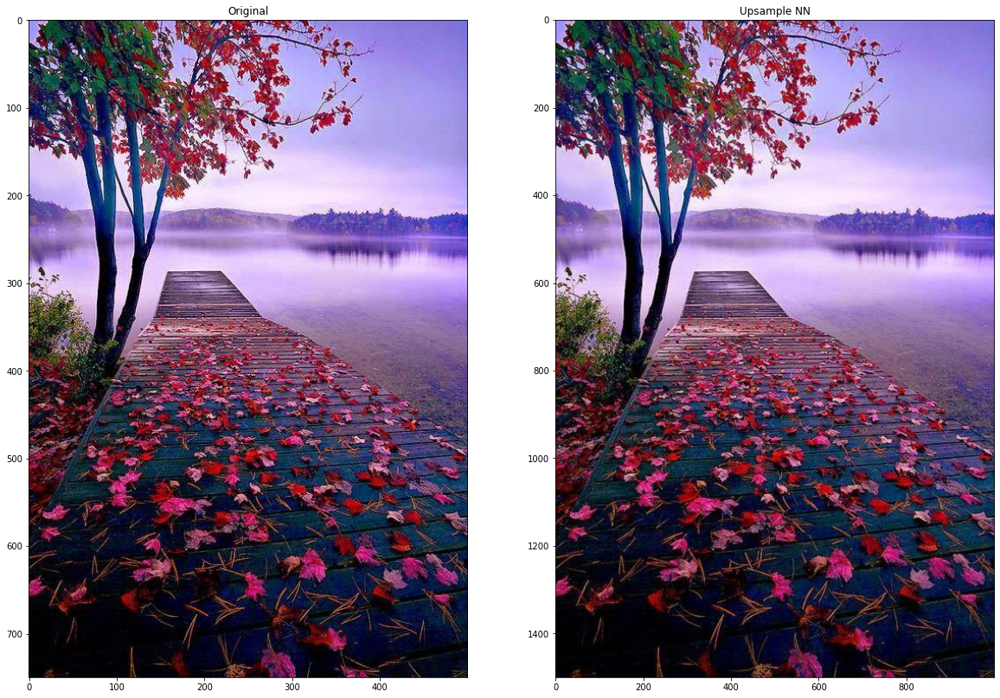

In [7]:
show2_img (im, image_resized, title='Upsample NN', size = (20,20))

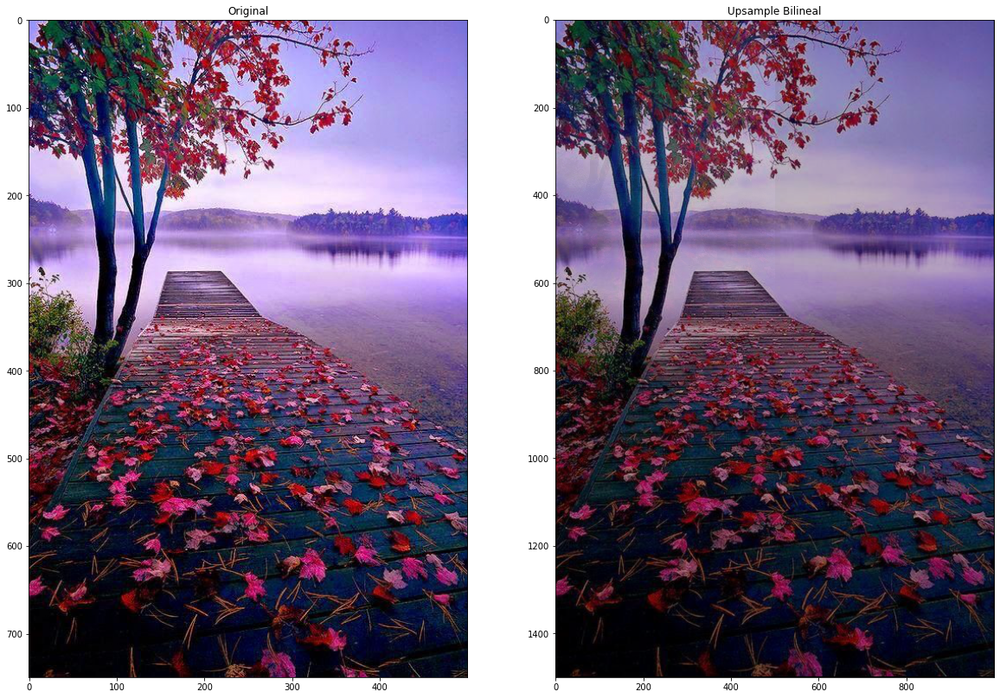

In [8]:
image_resized = resize_image(im,modo='bilinear',upsample=True)
show2_img (im, image_resized, title='Upsample Bilineal', size = (20,20))

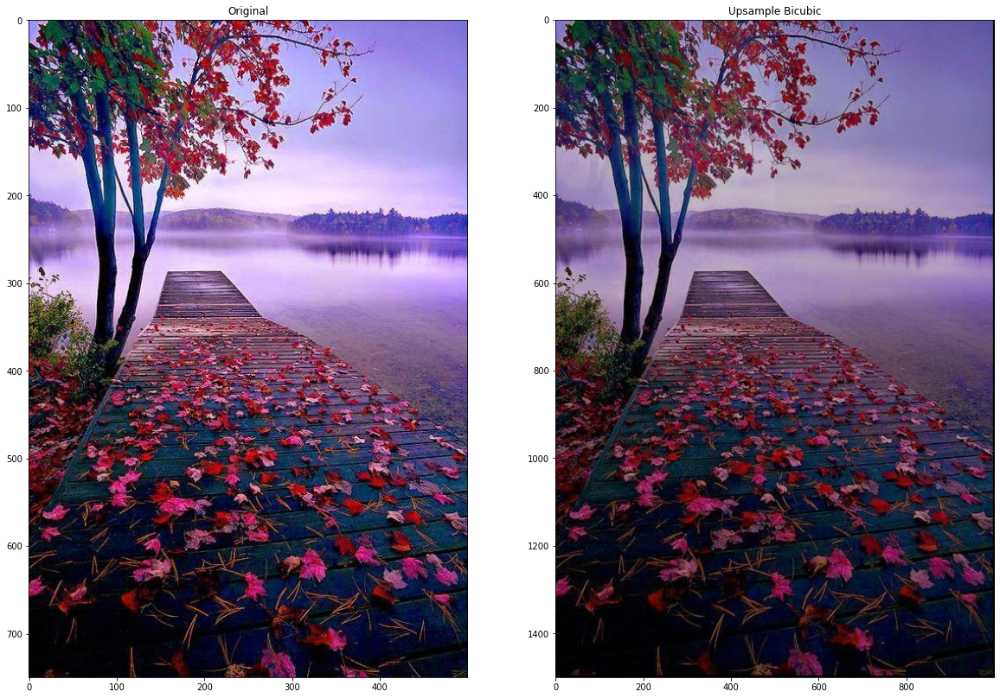

In [9]:
image_resized = resize_image(im,modo='bicubic',upsample=True)
show2_img (im, image_resized, title='Upsample Bicubic', size = (20,20))

Podemos observar que la técnica NN matiene las intensidades en general ya que "copia" los píxeles, al ser una imagen grande, funciona correctamente. Si tendríamos una imagen más chica, usar NN nos produciría un problema mayor porque los píxeles copiados afectaría la visualización de la imagen. En el caso de las técnicas bilineal y bicubica, vemos que la imagen se oscurece por aplicar un kernel de promedio en la primera y el kernel bicubico en la segunda, lo que nos dará un píxel interpolado con igual o menor intensidad en general.

### Downsample x2

In [10]:
#@title Imágenes de Entrada: { run: "auto" }
dict_urls = {'Auto':'https://www.recambiooriginal.com/wp-content/uploads/2018/11/pintura_negra_coche_ventajas_inconvenientes_3-800x400.jpg',
             'Edificio':'https://s3-sa-east-1.amazonaws.com/modernabuenosaires/img/obras/galeria/888_1506021627.jpg',
             'Muralla':'https://upload.wikimedia.org/wikipedia/commons/thumb/2/23/The_Great_Wall_of_China_at_Jinshanling-edit.jpg/1200px-The_Great_Wall_of_China_at_Jinshanling-edit.jpg',
             'Senor':'https://akvis.com/img/examples/retoucher/man-photoshop/source.jpg'
            }

Imagen1 = 'Edificio' #@param ["Auto","Edificio","Muralla","Senor"]
im = get_and_read_img(dict_urls[Imagen1])


image_resized = resize_image(im)

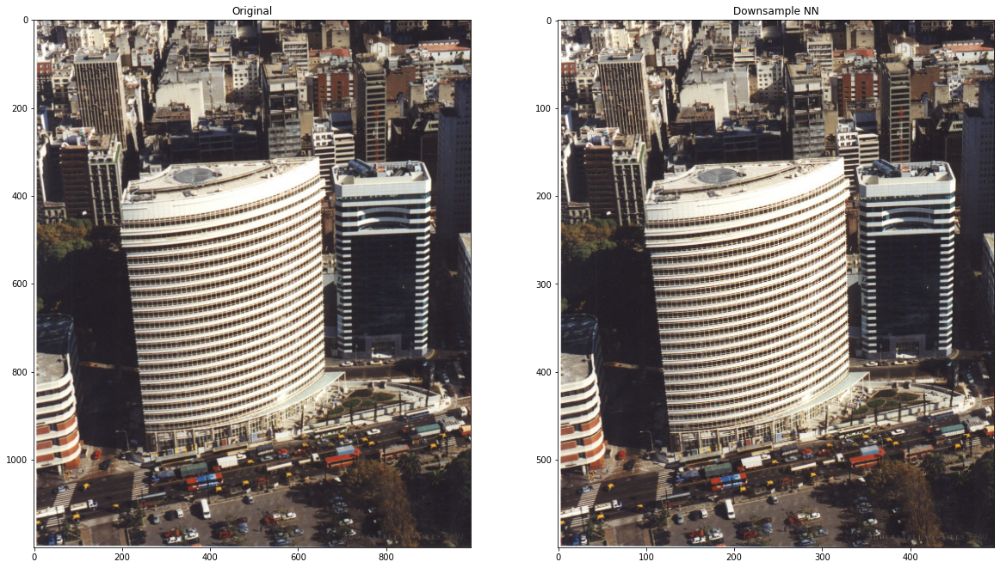

In [11]:
image_resized = resize_image(im,modo='nn',upsample=False)
show2_img (im, image_resized, title='Downsample NN', size = (20,20))

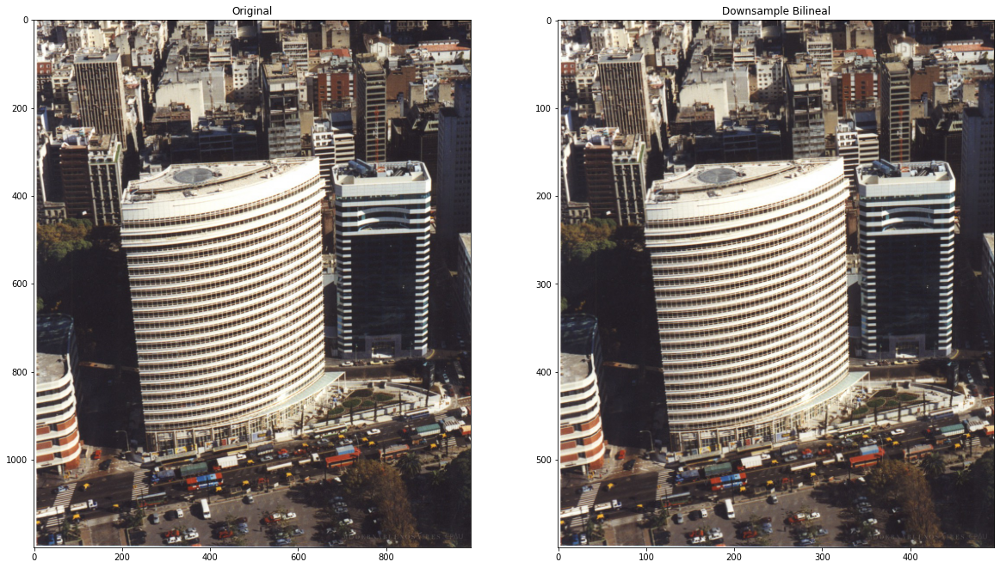

In [12]:
image_resized = resize_image(im,modo='bilinear',upsample=False)
show2_img (im, image_resized, title='Downsample Bilineal', size = (20,20))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


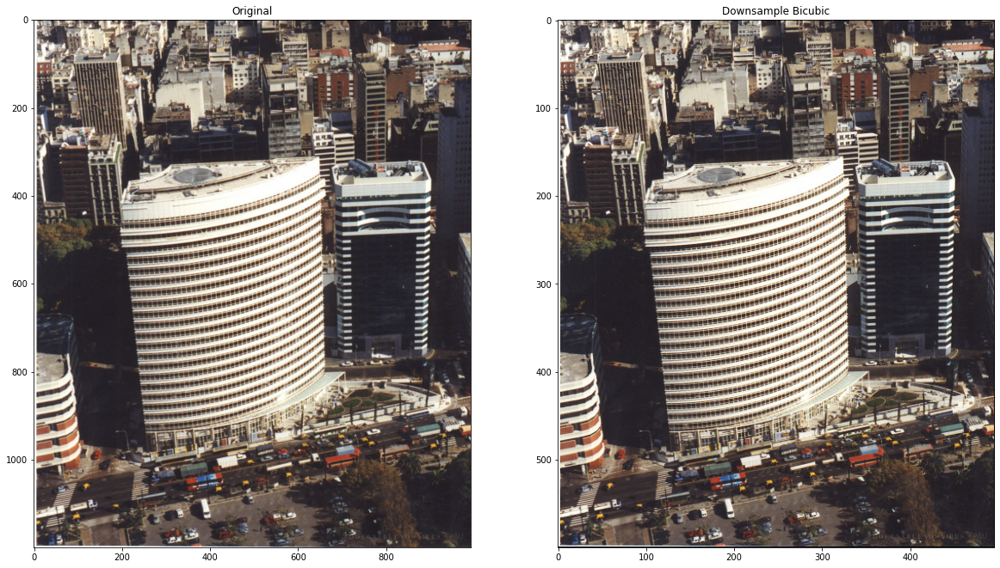

In [13]:
image_resized = resize_image(im,modo='bicubic',upsample=False)
show2_img (im, image_resized, title='Downsample Bicubic', size = (20,20))

En el caso del downsample se pueden ver los problemas en el edificio blanco principal por tener componentes de más alta frecuencia. Puede observarse también que los métodos bilineal y bicubico la representación de las ventanas de ese edificio se pueden notar más claramente.

### 2 Aplicar técnicas de cuantización

### 2.1 Funciones de cuantización uniforme, dithering aleatorio, y difusión del error por scan-line.

In [14]:
#@title Imágenes de Entrada: { run: "auto" }
dict_urls = {'Auto':'https://www.recambiooriginal.com/wp-content/uploads/2018/11/pintura_negra_coche_ventajas_inconvenientes_3-800x400.jpg',
             'Edificio':'https://s3-sa-east-1.amazonaws.com/modernabuenosaires/img/obras/galeria/888_1506021627.jpg',
             'Muralla':'https://upload.wikimedia.org/wikipedia/commons/thumb/2/23/The_Great_Wall_of_China_at_Jinshanling-edit.jpg/1200px-The_Great_Wall_of_China_at_Jinshanling-edit.jpg',
             'Senor':'https://akvis.com/img/examples/retoucher/man-photoshop/source.jpg'
            }

Imagen1 = 'Muralla' #@param ["Auto","Edificio","Muralla","Senor"]
im = get_and_read_img(dict_urls[Imagen1])


image_resized = resize_image(im)


### Uniforme

In [15]:
def uniform_cuant (im, n_valores = 100):
  paso = 1.0/n_valores

  cuant_im = im.copy()

  for k in range(len(im[0][0])):
    for i in range(len(im)):
      for j in range(len(im[0])):
        cuant_im[i][j][k] = int(im[i][j][k]/paso) * paso
  return cuant_im


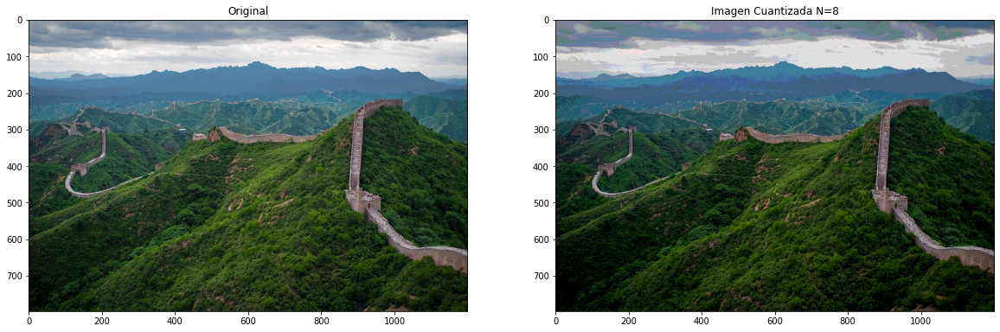

In [16]:
#@title Cantidad de bines del histograma: { run: "auto" }

N = 8 #@param {type:"slider", min:1, max:255, step:1}
imagen_cuant = uniform_cuant(im,N)
show2_img(im,imagen_cuant,"Imagen Cuantizada N=%d"%N)

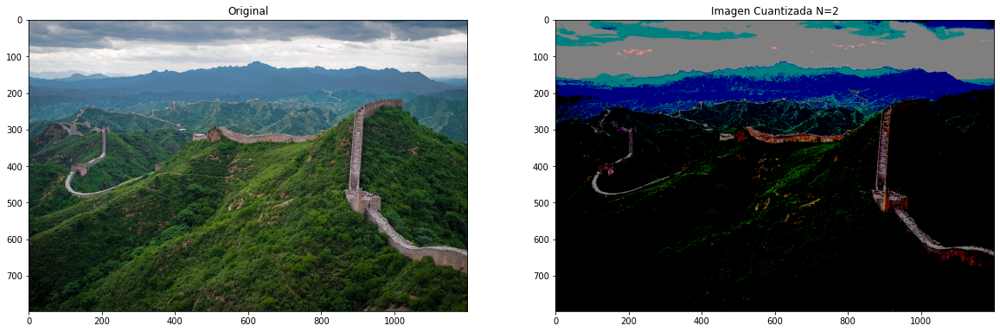

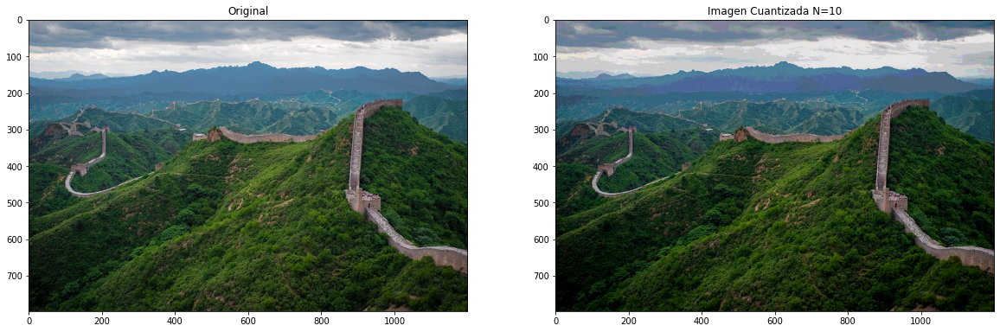

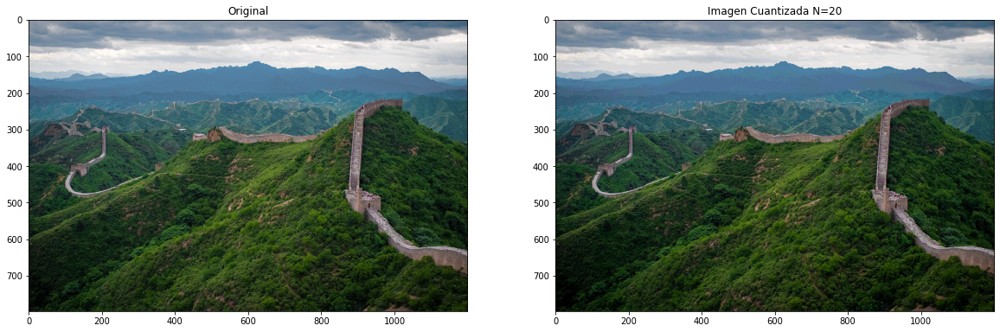

In [17]:
N_s = [2,10,20]
for i in N_s:
  imagen_cuant = uniform_cuant(im,i)
  show2_img(im,imagen_cuant,"Imagen Cuantizada N=%d"%i)

Puede observarse que con pocos intervalos de representación de los píxeles, los problemas se ven en la parte del cielo, a medida que aumentamos los bits en los cuales representamos las luminancias, se va mitigando este problema.

### Dithering aleatorio

In [18]:
#@title Cantidad de bines del histograma: { run: "auto" }

N = 8 #@param {type:"slider", min:1, max:255, step:1}

import random

def dithering_cuant (im, N):
  cuant_im = im.copy()
  paso = 1./N
  for k in range(len(im[0][0])):
    for i in range(len(im)):
      for j in range(len(im[0])):
        cnt = 0
        for h in range(N):
          if (im[i][j][k] > random.random()):
            cnt += 1
        cuant_im[i][j][k] = cnt*paso
  return cuant_im

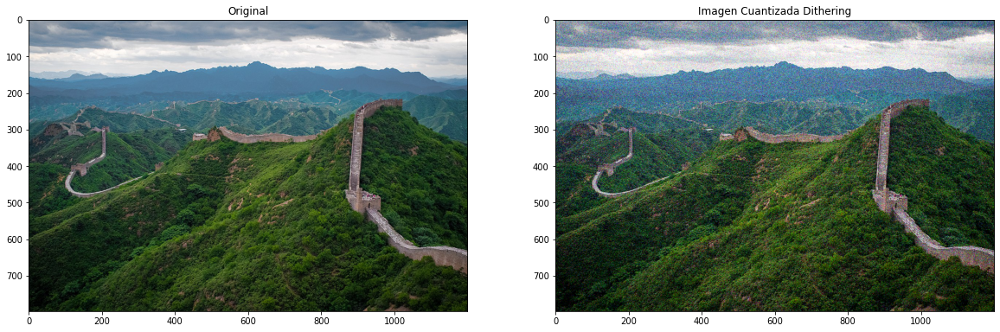

In [19]:
imagen_cuant = dithering_cuant(im,N)
show2_img(im,imagen_cuant,"Imagen Cuantizada Dithering")

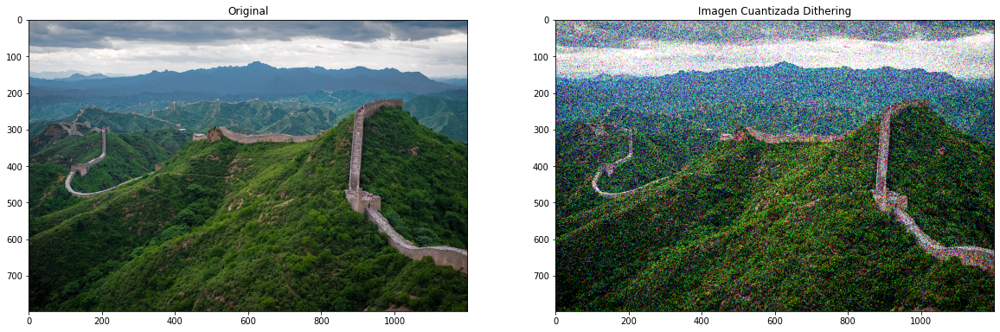

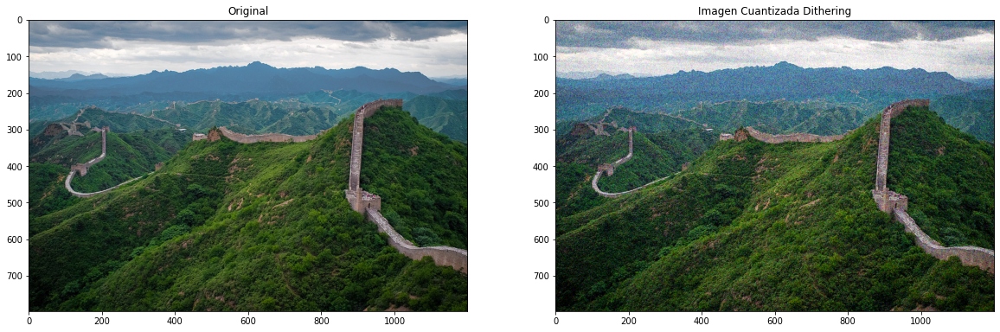

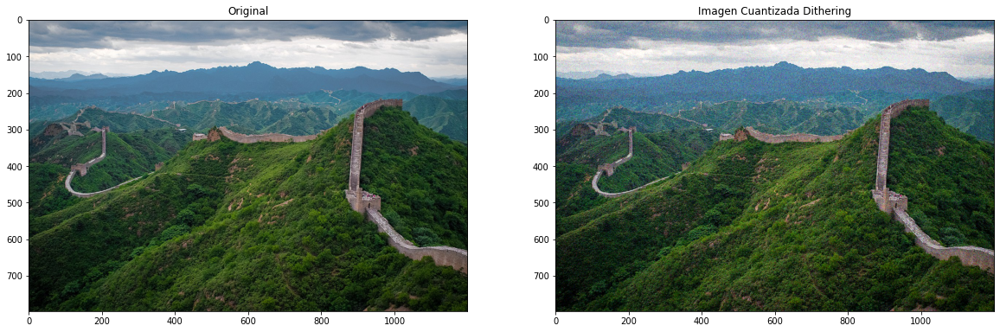

In [20]:
N = [1,10,20]

for n in N:
  imagen_cuant = dithering_cuant(im,n)
  show2_img(im,imagen_cuant,"Imagen Cuantizada Dithering")

La diferencia respecto al método anterior es que el espectro del error ahora no se concentra en 40 osc/scan-line sino que al utilizar una distribución uniforme a la hora de cuantizar "aplanamos" ese espectro. Esto mejora en la percepción que obtenemos a través de nuestros ojos de la imagen. Como puede observarse, con los mismos niveles de cuantización, obtenemos mejores resultados respecto a la implementación de NN

### Difusión del error por scan-line

In [26]:
def error_dif_cuant (im, N):
  cuant_im = im.copy()
  paso = 1./N
  for k in range(len(im[0][0])):
    for i in range(len(im[0])):
      error = 0
      for j in range(len(im)):
        cnt = 0
        for h in range(N-1):
          cnt += (im[j][i][k] + error) < paso*h
        cuant_im[j][i][k] = cnt*paso
        error = error + (cuant_im[j][i][k] - im[j][i][k])
  return cuant_im

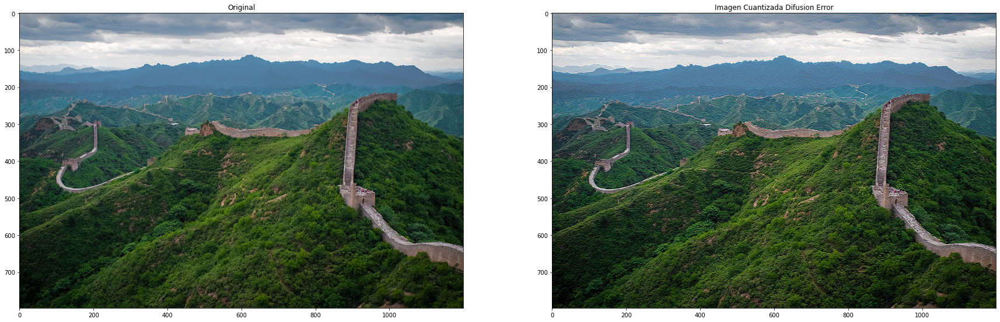

In [24]:
#@title Cantidad de bines del histograma: { run: "auto" }

N = 4 #@param {type:"slider", min:1, max:255, step:1}

imagen_cuant = error_dif_cuant(im,N)
show2_img(im,imagen_cuant,"Imagen Cuantizada Difusion Error",size=(30,30))

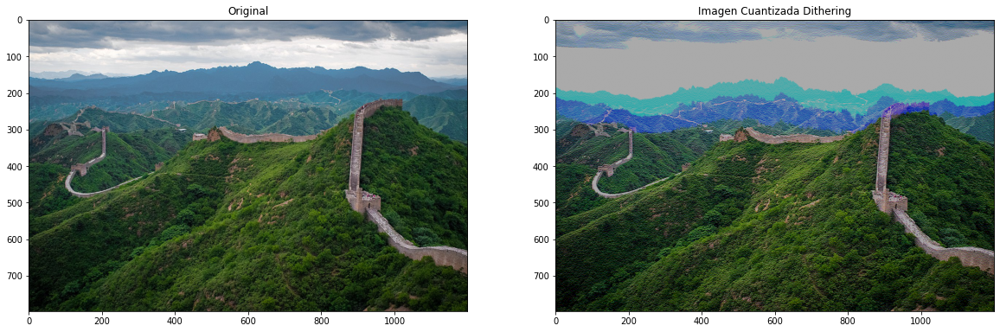

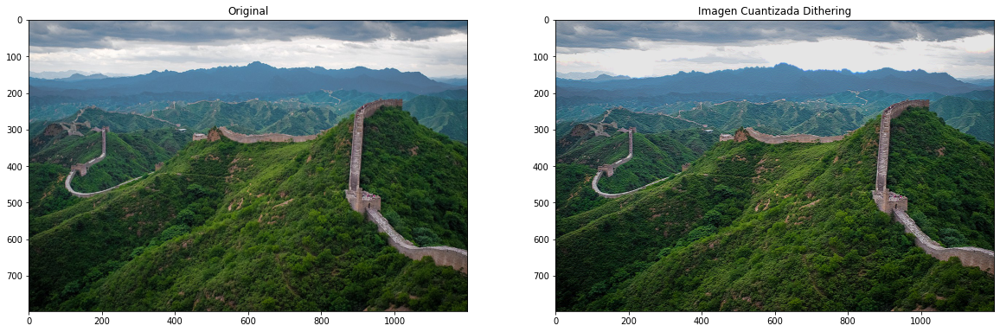

In [28]:
N = [3,10]

for n in N:
  imagen_cuant = error_dif_cuant(im,n)
  show2_img(im,imagen_cuant,"Imagen Cuantizada Difusion de error")

En el caso de la difusión de error por scan-line se tiene un umbral variable, lo que hace las imágenes tengan una señal de error con menos componentes en las bajas frecuencias. Se pueden observar las "curvas de nivel" por movernos en scan lines en la cuantización con pocos niveles.

### 3. Conclusiones Generales

En el trabajo práctico se pudo implementar con éxito diferentes técnicas de interpolación y diezmado en imágenes, observándose así las ventajas y desventajas de cada una y los efectos que produce en las imágenes este tipo de algoritmos.  
Además, se cuantizó las imágenes en una cantidad menor de bits para la representación de luminancia observando la degradación en la representación. Se implementaron diferentes técnicas para obtener el mejor resultado posible con los niveles de cuantización dados.